importing the Turi Create package and the pyplot module of the Matplotlib package

In [1]:
import turicreate as tc
import matplotlib.pyplot as plt

loads all the images from the snacks/train directory into an SFrame, the data container for Turi Create.

In [2]:
train_data = tc.image_analysis.load_images("snacks/train", with_path=True)

In [3]:
len(train_data)

4838

In [4]:
train_data.head()

path,image
snacks/train/apple/007a0bec00a90a66.jpg ...,Height: 341 Width: 256
snacks/train/apple/007ec56b6529e036.jpg ...,Height: 256 Width: 341
snacks/train/apple/00881627629888f6.jpg ...,Height: 256 Width: 384
snacks/train/apple/00bb5720a7ba062e.jpg ...,Height: 256 Width: 341
snacks/train/apple/00cc1c601b23f73d.jpg ...,Height: 256 Width: 341
snacks/train/apple/01477ea37494a8ac.jpg ...,Height: 256 Width: 382
snacks/train/apple/018257a792aa90e6.jpg ...,Height: 256 Width: 256
snacks/train/apple/01968ea73417ec3b.jpg ...,Height: 256 Width: 256
snacks/train/apple/01ecc03a12e21e39.jpg ...,Height: 256 Width: 446
snacks/train/apple/021d2569ce62aa93.jpg ...,Height: 256 Width: 341


This opens a new window with image thumbnails

/Users/itsupport/anaconda3/envs/turienv/lib/python3.7/site-packages/turicreate/visualization/_plot.py:376: UserWarning: Displaying only the first 100 rows.
  warnings.warn('Displaying only the first {} rows.'.format(maximum_rows))


,path,image
0,snacks/train/apple/007a0bec00a90a66.jpg,
1,snacks/train/apple/007ec56b6529e036.jpg,
2,snacks/train/apple/00881627629888f6.jpg,
3,snacks/train/apple/00bb5720a7ba062e.jpg,
4,snacks/train/apple/00cc1c601b23f73d.jpg,
5,snacks/train/apple/01477ea37494a8ac.jpg,
6,snacks/train/apple/018257a792aa90e6.jpg,
7,snacks/train/apple/01968ea73417ec3b.jpg,
8,snacks/train/apple/01ecc03a12e21e39.jpg,
9,snacks/train/apple/021d2569ce62aa93.jpg,

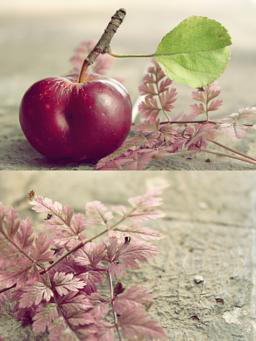
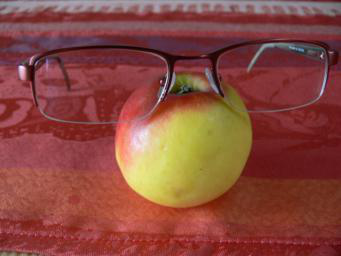
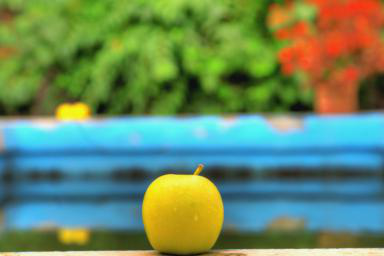
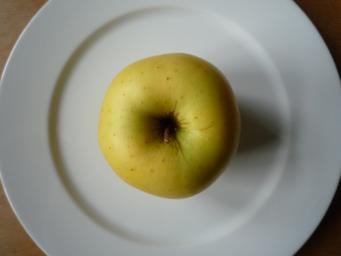
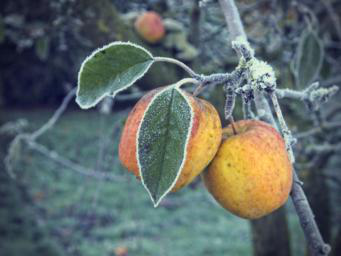
...
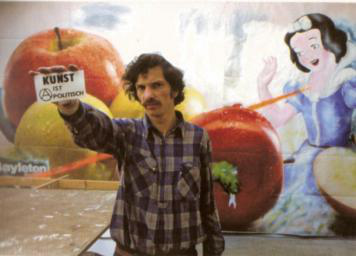
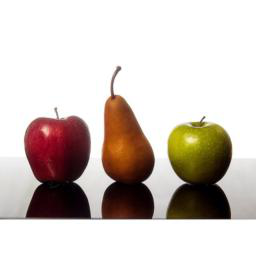
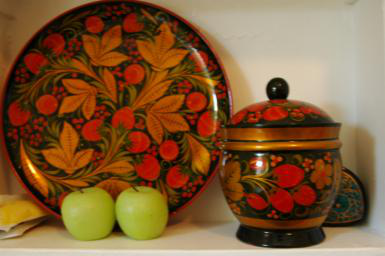
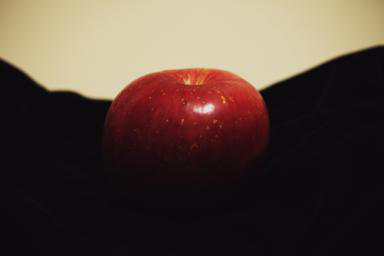
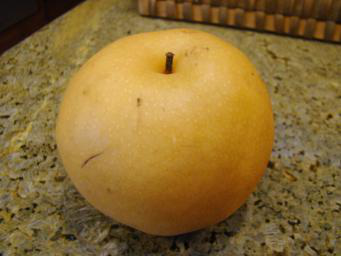

In [5]:
train_data.explore()

using Matplotlib’s imshow() look at individual images directly inside the notebook

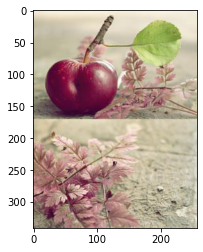

In [6]:
plt.imshow(train_data[0]["image"].pixel_data)

extract the class name from the path

In [7]:
# Grab the full path of the first training example
path = train_data[0]["path"]
print(path)

snacks/train/apple/007a0bec00a90a66.jpg


In [8]:
# Find the class label
import os 
os.path.basename(os.path.split(path)[0])

'apple'

SFrame has a handy apply() method that, like Swift’s map or forEach, lets you apply a function to every row in the frame

In [9]:
 train_data["label"] = train_data["path"].apply(lambda path: os.path.basename(os.path.split(path)[0]))

In [10]:
train_data["label"].summary()


+------------------+-------+----------+
|       item       | value | is exact |
+------------------+-------+----------+
|      Length      |  4838 |   Yes    |
| # Missing Values |   0   |   Yes    |
| # unique values  |   20  |    No    |
+------------------+-------+----------+

Most frequent items:
+-----------+-------+
|   value   | count |
+-----------+-------+
| pineapple |  260  |
|   apple   |  250  |
|   banana  |  250  |
|  doughnut |  250  |
|   grape   |  250  |
|  hot dog  |  250  |
| ice cream |  250  |
|   juice   |  250  |
|   muffin  |  250  |
|   salad   |  250  |
+-----------+-------+


In [11]:
train_data["label"].value_counts().print_rows(num_rows=20)

+------------+-------+
|   value    | count |
+------------+-------+
| pineapple  |  260  |
|   juice    |  250  |
|   banana   |  250  |
|   apple    |  250  |
|  doughnut  |  250  |
| watermelon |  250  |
|   waffle   |  250  |
|   muffin   |  250  |
|   salad    |  250  |
| ice cream  |  250  |
|  hot dog   |  250  |
|   grape    |  250  |
|   carrot   |  249  |
|    cake    |  249  |
|   cookie   |  249  |
|   orange   |  249  |
|   candy    |  249  |
| strawberry |  249  |
|  popcorn   |  180  |
|  pretzel   |  154  |
+------------+-------+
[20 rows x 2 columns]



/Users/itsupport/anaconda3/envs/turienv/lib/python3.7/site-packages/turicreate/aggregate.py:91: UserWarning: Passing parameter(s) to COUNT is deprecated. This functionality will be removed in the next major release. Any passed parameters are ignored.
  warnings.warn('Passing parameter(s) to COUNT is deprecated. This functionality will be removed in '


Once you have your data in an SFrame train your model with TuriCreate

SqueezeNet and VisionFeaturePrint_Screen are convolutional neural networks. 

In [14]:
# model = tc.image_classifier.create(train_data, target="label",
# model="VisionFeaturePrint_Scene", max_iterations=50)
# verbose=True
model = tc.load_model("HealthySnacks.model")
# to load instead of training it: model = tc.load_model("HealthySnacks-Turi.model")

Testing

Run these commands to load the test dataset and get the class labels

In [15]:
test_data = tc.image_analysis.load_images("snacks/test", with_path=True)
test_data["label"] = test_data["path"].apply(lambda path: os.path.basename(os.path.split(path)[0]))
len(test_data)

952

evaluate the model and collect metrics

In [16]:
metrics = model.evaluate(test_data)

Analyzing and extracting image features.

+------------------+--------------+------------------+

| Images Processed | Elapsed Time | Percent Complete |

+------------------+--------------+------------------+

| 64               | 43.54s       | 6.5%             |

| 128              | 43.62s       | 13.25%           |

| 192              | 43.71s       | 20%              |

| 256              | 43.79s       | 26.5%            |

| 320              | 43.88s       | 33.25%           |

| 640              | 1m 24s       | 66.5%            |

| 952              | 1m 25s       | 100%             |

+------------------+--------------+------------------+

In [17]:
print("Accuracy: ", metrics["accuracy"]) 
print("Precision: ", metrics["precision"]) 
print("Recall: ", metrics["recall"])
print("Confusion Matrix:\n", metrics["confusion_matrix"])

Accuracy:  0.8613445378151261
Precision:  0.8664934344897859
Recall:  0.8627746598639456
Confusion Matrix:
 +--------------+-----------------+-------+
| target_label | predicted_label | count |
+--------------+-----------------+-------+
|    grape     |      grape      |   46  |
|    cookie    |    pineapple    |   1   |
|    juice     |    pineapple    |   2   |
|  watermelon  |       cake      |   1   |
|  ice cream   |      cookie     |   1   |
|    grape     |    pineapple    |   2   |
|   hot dog    |      orange     |   1   |
|  ice cream   |      muffin     |   2   |
|  ice cream   |      banana     |   1   |
|    cookie    |      muffin     |   5   |
+--------------+-----------------+-------+
[105 rows x 3 columns]
Note: Only the head of the SFrame is printed.
You can use print_rows(num_rows=m, num_columns=n) to print more rows and columns.


In [18]:
model

Class                                    : ImageClassifier

Schema
------
Number of classes                        : 20
Number of feature columns                : 1
Input image shape                        : (3, 299, 299)

Training summary
----------------
Number of examples                       : 4596
Training loss                            : 1.648
Training time (sec)                      : 449.4974

In [ ]:
#model.save("HealthySnacksTuri.model")

In [ ]:
#model.export_coreml("HealthySnacksTuri.mlmodel")

Chapter 5

Instead of training with VisionFeature, we'll use SqueezeNet

Squeezenet extract only 1000 features from 227×227-pixel images, compared with 2048 of VisionFeature from 299×299 images

In [20]:
model = tc.image_classifier.create(train_data, target="label", model="squeezenet_v1.1", verbose=True,
max_iterations=100)

Analyzing and extracting image features.

+------------------+--------------+------------------+

| Images Processed | Elapsed Time | Percent Complete |

+------------------+--------------+------------------+

| 64               | 654.081ms    | 1.25%            |

| 128              | 909.861ms    | 2.5%             |

| 192              | 1.16s        | 3.75%            |

| 256              | 1.43s        | 5.25%            |

| 320              | 1.68s        | 6.5%             |

| 640              | 2.93s        | 13%              |

| 1600             | 6.54s        | 32.75%           |

| 3200             | 13.58s       | 65.75%           |

| 4800             | 21.74s       | 98.5%            |

| 4838             | 21.94s       | 100%             |

+------------------+--------------+------------------+

PROGRESS: Creating a validation set from 5 percent of training data. This may take a while.
          You can set ``validation_set=None`` to disable validation tracking.



Logistic regression:

--------------------------------------------------------

Number of examples          : 4596

Number of classes           : 20

Number of feature columns   : 1

Number of unpacked features : 1000

Number of coefficients      : 19019

Starting L-BFGS

--------------------------------------------------------

+-----------+----------+-----------+--------------+-------------------+---------------------+

| Iteration | Passes   | Step size | Elapsed Time | Training Accuracy | Validation Accuracy |

+-----------+----------+-----------+--------------+-------------------+---------------------+

| 0         | 4        | 0.250000  | 0.803890     | 0.111184          | 0.128099            |

| 1         | 7        | 1.250000  | 1.626559     | 0.296780          | 0.276860            |

| 2         | 8        | 1.250000  | 2.375010     | 0.150131          | 0.140496            |

| 3         | 9        | 1.250000  | 2.867023     | 0.281332          | 0.280992            |

| 4         | 10       | 1.250000  | 3.297090     | 0.280026          | 0.268595            |

| 9         | 16       | 1.000000  | 5.154567     | 0.448433          | 0.446281            |

| 14        | 22       | 1.000000  | 6.680987     | 0.475413          | 0.438017            |

| 19        | 29       | 0.945881  | 8.312532     | 0.575065          | 0.533058            |

| 24        | 34       | 1.000000  | 9.565817     | 0.603786          | 0.570248            |

| 29        | 40       | 1.000000  | 10.912113    | 0.628372          | 0.599174            |

| 34        | 50       | 0.521369  | 12.656568    | 0.650131          | 0.611570            |

| 39        | 56       | 1.000000  | 13.985354    | 0.672977          | 0.615702            |

| 44        | 65       | 1.000000  | 15.516715    | 0.680157          | 0.619835            |

| 49        | 71       | 1.000000  | 16.804229    | 0.703438          | 0.623967            |

| 54        | 78       | 1.000000  | 18.368836    | 0.714970          | 0.673554            |

| 59        | 90       | 1.396309  | 20.185297    | 0.724326          | 0.669421            |

| 64        | 96       | 1.287711  | 21.416821    | 0.738033          | 0.661157            |

| 69        | 103      | 1.000000  | 22.832132    | 0.727589          | 0.619835            |

| 74        | 112      | 1.173951  | 24.462640    | 0.748912          | 0.673554            |

| 79        | 119      | 0.919088  | 25.911771    | 0.767406          | 0.665289            |

| 84        | 124      | 1.000000  | 27.151530    | 0.774369          | 0.673554            |

| 89        | 129      | 1.000000  | 28.480408    | 0.782202          | 0.661157            |

| 94        | 140      | 1.586803  | 30.366777    | 0.790470          | 0.648760            |

| 99        | 146      | 1.000000  | 31.718946    | 0.799173          | 0.636364            |

+-----------+----------+-----------+--------------+-------------------+---------------------+

In [21]:
metrics = model.evaluate(test_data) 
print("Accuracy: ", metrics["accuracy"]) 
print("Precision: ", metrics["precision"]) 
print("Recall: ", metrics["recall"])

Analyzing and extracting image features.

+------------------+--------------+------------------+

| Images Processed | Elapsed Time | Percent Complete |

+------------------+--------------+------------------+

| 64               | 730.354ms    | 6.5%             |

| 128              | 998.096ms    | 13.25%           |

| 192              | 1.28s        | 20%              |

| 256              | 1.55s        | 26.5%            |

| 320              | 1.83s        | 33.25%           |

| 640              | 3.09s        | 66.5%            |

| 952              | 4.25s        | 100%             |

+------------------+--------------+------------------+

Accuracy:  0.6607142857142857
Precision:  0.6629829400841369
Recall:  0.6577780612244898


Compare the result we got in Vision

only available in Mac ... 

In [22]:
metrics.explore()

Resizing image data... Done.


The first 50 images are apples... let's check the prediction

In [23]:
model.predict(test_data)

dtype: str
Rows: 952
['apple', 'grape', 'orange', 'orange', 'orange', 'apple', 'orange', 'juice', 'candy', 'apple', 'grape', 'apple', 'strawberry', 'apple', 'apple', 'carrot', 'candy', 'ice cream', 'apple', 'apple', 'apple', 'apple', 'apple', 'apple', 'apple', 'pineapple', 'orange', 'apple', 'apple', 'apple', 'doughnut', 'grape', 'apple', 'apple', 'orange', 'grape', 'apple', 'orange', 'apple', 'grape', 'apple', 'orange', 'grape', 'apple', 'orange', 'apple', 'apple', 'apple', 'apple', 'apple', 'banana', 'banana', 'pineapple', 'carrot', 'hot dog', 'banana', 'banana', 'banana', 'banana', 'banana', 'banana', 'banana', 'banana', 'banana', 'banana', 'banana', 'hot dog', 'banana', 'banana', 'banana', 'banana', 'pineapple', 'banana', 'banana', 'banana', 'banana', 'banana', 'banana', 'juice', 'watermelon', 'hot dog', 'banana', 'pretzel', 'banana', 'banana', 'banana', 'banana', 'banana', 'banana', 'banana', 'banana', 'apple', 'watermelon', 'banana', 'grape', 'banana', 'orange', 'banana', 'banana

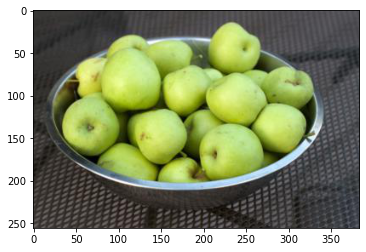

In [28]:
plt.imshow(test_data[1]["image"].pixel_data)

get the probability for each prediction

In [30]:
output = model.classify(test_data)
output

class,probability
apple,0.383579256562522
grape,0.6836078912008997
orange,0.3072494547919965
orange,0.8612138804914833
orange,0.39807397160559777
apple,0.9676622057245713
orange,0.5242716166944349
juice,0.38733683018721565
candy,0.4999398634261456
apple,0.9139278786043887


/Users/itsupport/anaconda3/envs/turienv/lib/python3.7/site-packages/turicreate/visualization/_plot.py:376: UserWarning: Displaying only the first 100 rows.
  warnings.warn('Displaying only the first {} rows.'.format(maximum_rows))


,path,image,label,class,probability
0,snacks/test/apple/00341c3c5825fc7e.jpg,,apple,apple,0.383579
1,snacks/test/apple/004be96d7985d83e.jpg,,apple,grape,0.683608
2,snacks/test/apple/01ac2a42f2a22ee7.jpg,,apple,orange,0.307249
3,snacks/test/apple/03bfc0b1cc6bde63.jpg,,apple,orange,0.861214
4,snacks/test/apple/09ed54b36eaa5316.jpg,,apple,orange,0.398074
5,snacks/test/apple/0f8670e41c97c8cb.jpg,,apple,apple,0.967662
6,snacks/test/apple/137591bb5ac95a5e.jpg,,apple,orange,0.524272
7,snacks/test/apple/1382c47d4df56b77.jpg,,apple,juice,0.387337
8,snacks/test/apple/1acfd560a4424e04.jpg,,apple,candy,0.499940
9,snacks/test/apple/1db0cb75f37d6cba.jpg,,apple,apple,0.913928

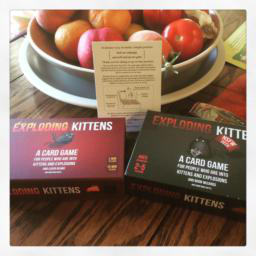
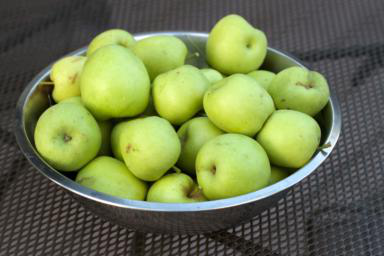
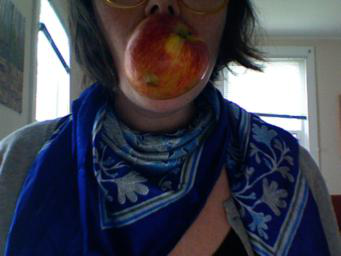
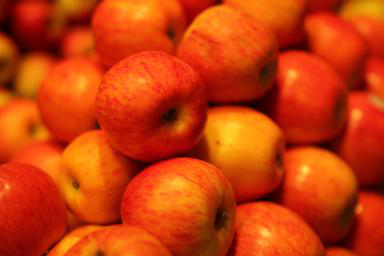
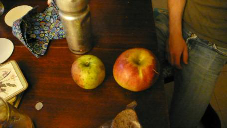
...
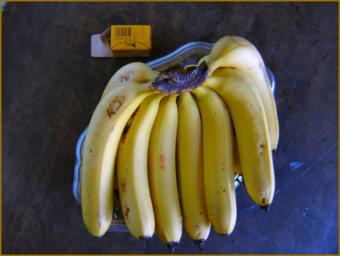
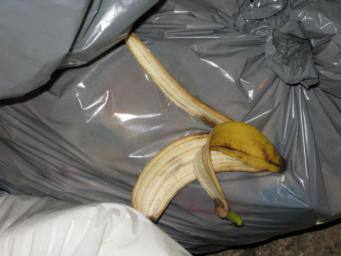
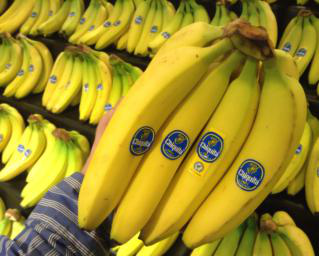
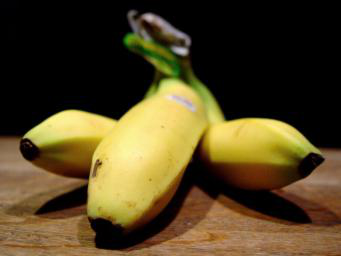
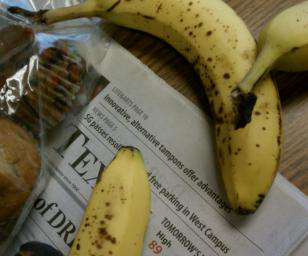

In [31]:
imgs_with_pred = test_data.add_columns(output) 
imgs_with_pred.explore()

filters the SFrame to include only those rows with high-probability wrong predictions. 
The first term selects the rows whose probability column has a value greater than 90%, 
the second term selects the rows where the label and class columns are not the same.

,path,image,label,class,probability
0,snacks/test/apple/953a08e8cfa4dfce.jpg,,apple,grape,0.904977
1,snacks/test/banana/0fb15f6f8289bf78.jpg,,banana,pineapple,0.936977
2,snacks/test/banana/33e2d11aef91defb.jpg,,banana,hot dog,0.989127
3,snacks/test/banana/89ed54d428adb296.jpg,,banana,hot dog,0.924759
4,snacks/test/cake/1c95483323464b46.jpg,,cake,muffin,0.959473
5,snacks/test/candy/0f4aa7ed9302d084.jpg,,candy,strawberry,0.949146
6,snacks/test/candy/20d938b9cc57b4bd.jpg,,candy,strawberry,0.928322
7,snacks/test/cookie/4b737307404fd0b8.jpg,,cookie,doughnut,0.919330
8,snacks/test/cookie/50d60abbaffa1e9e.jpg,,cookie,muffin,0.970161
9,snacks/test/cookie/62c898713b2ac490.jpg,,cookie,muffin,0.966016

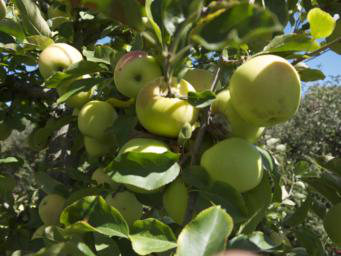
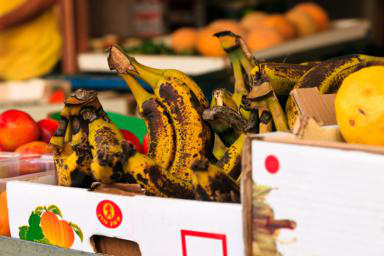
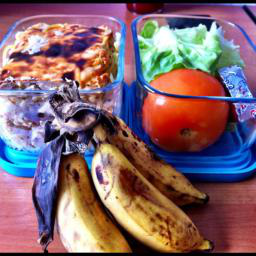
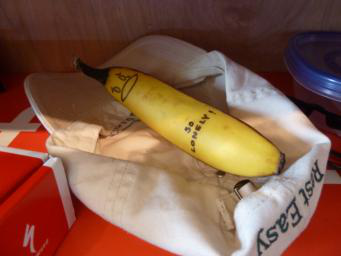
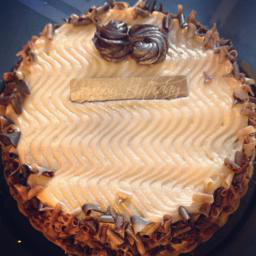
...
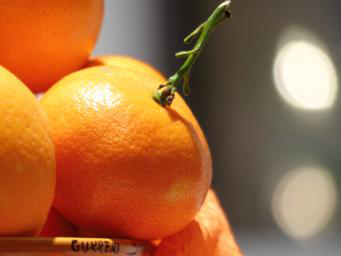
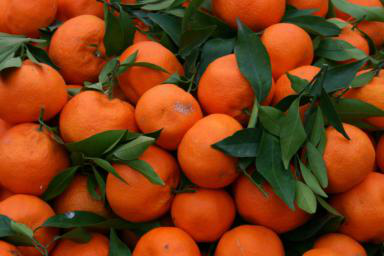
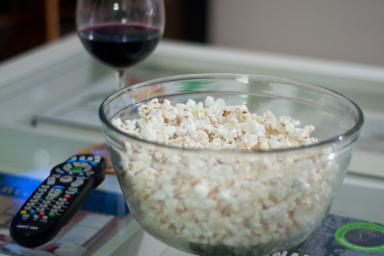
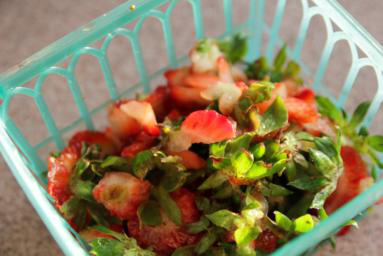
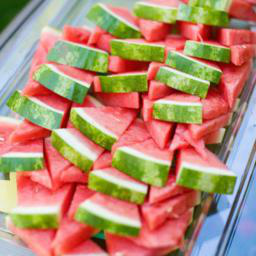

In [32]:
imgs_filtered = imgs_with_pred[(imgs_with_pred["probability"] >
0.9) &
(imgs_with_pred["label"] != imgs_with_pred["class"] )]
imgs_filtered.explore()



Sorting the prediction probabilities

Turi Create’s predict() method can also give you the probability distribution for each image.

In [33]:
 predictions = model.predict(test_data, output_type="probability_vector")

The probabilities are sorted alphanumerically by name of the class in the training set, so the first value is for “apple,” the second is “banana,”

In [34]:
print("Probabilities for 2nd image", predictions[1])

Probabilities for 2nd image array('d', [0.19878473620566905, 0.011120017756215725, 1.5990981311285257e-05, 0.004282800364246885, 0.0023330734791123364, 0.0002605871819466472, 2.514663010288514e-05, 0.6836078912008997, 1.7482068130150095e-06, 1.1720608655615449e-05, 8.007943086483532e-06, 3.0953164367708333e-07, 0.09783602515386872, 0.0008695307843275067, 9.530523351369906e-06, 3.474797725013821e-08, 8.780871324285616e-05, 2.814573701182134e-05, 4.34463050678447e-07, 0.0007164597874664925])


In [35]:
labels = test_data["label"].unique().sort()
preds = tc.SArray(predictions[1])
tc.SFrame({"preds": preds, "labels": labels}).sort([("preds", False)])

labels,preds
grape,0.6836078912008997
apple,0.19878473620566905
orange,0.09783602515386872
banana,0.011120017756215725
candy,0.004282800364246885
carrot,0.0023330734791123364
pineapple,0.0008695307843275067
watermelon,0.0007164597874664925
cookie,0.0002605871819466472
salad,8.780871324285616e-05


In [37]:
val_data = tc.image_analysis.load_images("snacks/val", with_path=True)
val_data["label"] = val_data["path"].apply(lambda path:
os.path.basename(os.path.split(path)[0])) 
len(val_data)

955

In [38]:
model = tc.image_classifier.create(train_data, target="label", model="squeezenet_v1.1",
max_iterations=100,
verbose=True, validation_set=val_data)

Analyzing and extracting image features.

+------------------+--------------+------------------+

| Images Processed | Elapsed Time | Percent Complete |

+------------------+--------------+------------------+

| 64               | 767.614ms    | 1.25%            |

| 128              | 1.03s        | 2.5%             |

| 192              | 1.30s        | 3.75%            |

| 256              | 1.57s        | 5.25%            |

| 320              | 1.85s        | 6.5%             |

| 640              | 3.19s        | 13%              |

| 1600             | 7.14s        | 32.75%           |

| 3200             | 14.12s       | 65.75%           |

| 4800             | 21.13s       | 98.5%            |

| 4838             | 21.40s       | 100%             |

+------------------+--------------+------------------+

Analyzing and extracting image features.

+------------------+--------------+------------------+

| Images Processed | Elapsed Time | Percent Complete |

+------------------+--------------+------------------+

| 64               | 747.152ms    | 6.5%             |

| 128              | 982.353ms    | 13.25%           |

| 192              | 1.21s        | 20%              |

| 256              | 1.44s        | 26.5%            |

| 320              | 1.67s        | 33.25%           |

| 640              | 2.87s        | 66.5%            |

| 955              | 4.21s        | 100%             |

+------------------+--------------+------------------+

Logistic regression:

--------------------------------------------------------

Number of examples          : 4838

Number of classes           : 20

Number of feature columns   : 1

Number of unpacked features : 1000

Number of coefficients      : 19019

Starting L-BFGS

--------------------------------------------------------

+-----------+----------+-----------+--------------+-------------------+---------------------+

| Iteration | Passes   | Step size | Elapsed Time | Training Accuracy | Validation Accuracy |

+-----------+----------+-----------+--------------+-------------------+---------------------+

| 0         | 4        | 0.250000  | 0.488847     | 0.078338          | 0.070157            |

| 1         | 7        | 1.250000  | 0.971148     | 0.294750          | 0.273298            |

| 2         | 8        | 1.250000  | 1.233650     | 0.139107          | 0.150785            |

| 3         | 9        | 1.250000  | 1.480423     | 0.272013          | 0.268063            |

| 4         | 10       | 1.250000  | 1.725964     | 0.241835          | 0.213613            |

| 9         | 17       | 1.000000  | 3.105913     | 0.446465          | 0.406283            |

| 19        | 29       | 1.000000  | 5.835532     | 0.570897          | 0.526702            |

| 29        | 41       | 1.000000  | 8.514718     | 0.624845          | 0.570681            |

| 39        | 54       | 0.380831  | 11.184136    | 0.675486          | 0.592670            |

| 49        | 66       | 1.000000  | 13.974979    | 0.705043          | 0.607330            |

| 59        | 78       | 1.000000  | 16.972481    | 0.725506          | 0.619895            |

| 69        | 91       | 1.000000  | 20.260467    | 0.741835          | 0.614660            |

| 79        | 104      | 1.946333  | 23.552525    | 0.764779          | 0.618848            |

| 89        | 122      | 1.517558  | 27.096101    | 0.781521          | 0.619895            |

| 99        | 139      | 1.000000  | 30.394289    | 0.794750          | 0.627225            |

+-----------+----------+-----------+--------------+-------------------+---------------------+

In [41]:
model = tc.image_classifier.create(train_data, target="label", model="squeezenet_v1.1",
max_iterations=150,
verbose=True, validation_set=val_data)

Analyzing and extracting image features.

+------------------+--------------+------------------+

| Images Processed | Elapsed Time | Percent Complete |

+------------------+--------------+------------------+

| 64               | 699.25ms     | 1.25%            |

| 128              | 998.109ms    | 2.5%             |

| 192              | 1.28s        | 3.75%            |

| 256              | 1.56s        | 5.25%            |

| 320              | 1.85s        | 6.5%             |

| 640              | 3.39s        | 13%              |

| 1600             | 7.63s        | 32.75%           |

| 3200             | 15.49s       | 65.75%           |

| 4800             | 22.47s       | 98.5%            |

| 4838             | 22.77s       | 100%             |

+------------------+--------------+------------------+

Analyzing and extracting image features.

+------------------+--------------+------------------+

| Images Processed | Elapsed Time | Percent Complete |

+------------------+--------------+------------------+

| 64               | 899.727ms    | 6.5%             |

| 128              | 1.15s        | 13.25%           |

| 192              | 1.39s        | 20%              |

| 256              | 1.63s        | 26.5%            |

| 320              | 1.88s        | 33.25%           |

| 640              | 3.17s        | 66.5%            |

| 955              | 4.54s        | 100%             |

+------------------+--------------+------------------+

Logistic regression:

--------------------------------------------------------

Number of examples          : 4838

Number of classes           : 20

Number of feature columns   : 1

Number of unpacked features : 1000

Number of coefficients      : 19019

Starting L-BFGS

--------------------------------------------------------

+-----------+----------+-----------+--------------+-------------------+---------------------+

| Iteration | Passes   | Step size | Elapsed Time | Training Accuracy | Validation Accuracy |

+-----------+----------+-----------+--------------+-------------------+---------------------+

| 0         | 4        | 0.250000  | 0.512117     | 0.078338          | 0.070157            |

| 1         | 7        | 1.250000  | 0.992513     | 0.294750          | 0.273298            |

| 2         | 8        | 1.250000  | 1.237477     | 0.139107          | 0.150785            |

| 3         | 9        | 1.250000  | 1.503155     | 0.272013          | 0.268063            |

| 4         | 10       | 1.250000  | 1.763139     | 0.241835          | 0.213613            |

| 9         | 17       | 1.000000  | 3.221293     | 0.446465          | 0.406283            |

| 19        | 29       | 1.000000  | 5.902513     | 0.570897          | 0.526702            |

| 29        | 41       | 1.000000  | 8.921854     | 0.624845          | 0.570681            |

| 39        | 54       | 0.380831  | 11.742074    | 0.675486          | 0.592670            |

| 49        | 66       | 1.000000  | 14.595322    | 0.705043          | 0.607330            |

| 59        | 78       | 1.000000  | 17.310734    | 0.725506          | 0.619895            |

| 69        | 91       | 1.000000  | 20.131900    | 0.741835          | 0.614660            |

| 79        | 104      | 1.946333  | 23.079364    | 0.764779          | 0.618848            |

| 89        | 122      | 1.517558  | 26.625461    | 0.781521          | 0.619895            |

| 99        | 139      | 1.000000  | 30.675063    | 0.794750          | 0.627225            |

| 109       | 151      | 1.000000  | 35.061719    | 0.811906          | 0.620942            |

| 119       | 165      | 1.000000  | 39.880522    | 0.826995          | 0.623037            |

| 129       | 185      | 1.089900  | 45.887013    | 0.838776          | 0.633508            |

| 139       | 203      | 0.698440  | 50.850776    | 0.857792          | 0.634555            |

| 149       | 213      | 1.000000  | 54.435439    | 0.869781          | 0.637696            |

+-----------+----------+-----------+--------------+-------------------+---------------------+

In [42]:
metrics = model.evaluate(test_data) 
print("Accuracy: ", metrics["accuracy"]) 
print("Precision: ", metrics["precision"]) 
print("Recall: ", metrics["recall"])

Analyzing and extracting image features.

+------------------+--------------+------------------+

| Images Processed | Elapsed Time | Percent Complete |

+------------------+--------------+------------------+

| 64               | 718.498ms    | 6.5%             |

| 128              | 999.501ms    | 13.25%           |

| 192              | 1.29s        | 20%              |

| 256              | 1.57s        | 26.5%            |

| 320              | 1.80s        | 33.25%           |

| 640              | 3.10s        | 66.5%            |

| 952              | 4.23s        | 100%             |

+------------------+--------------+------------------+

Accuracy:  0.6491596638655462
Precision:  0.6483771913923803
Recall:  0.6455697278911564


The target_label column shows the real class, while predicted_label has the class that was predicted, and count is how many of this particular mistake were made.

The table shows the model predicted “hot dog” 3 times when the image was really “salad,” predicted “cake” twice when the image was really “ice cream,” and so on.

In [43]:
print("Confusion Matrix:\n", metrics["confusion_matrix"])

Confusion Matrix:
 +--------------+-----------------+-------+
| target_label | predicted_label | count |
+--------------+-----------------+-------+
|     cake     |    ice cream    |   2   |
|  pineapple   |      carrot     |   1   |
|    salad     |      candy      |   1   |
|   hot dog    |      salad      |   3   |
|    apple     |      grape      |   1   |
|  ice cream   |    ice cream    |   24  |
|    banana    |      juice      |   1   |
|    orange    |    pineapple    |   2   |
|    banana    |      muffin     |   2   |
|    waffle    |      candy      |   1   |
+--------------+-----------------+-------+
[208 rows x 3 columns]
Note: Only the head of the SFrame is printed.
You can use print_rows(num_rows=m, num_columns=n) to print more rows and columns.


In [47]:
import numpy as np
import seaborn as sns


def compute_confusion_matrix(metrics, labels): 
    num_labels = len(labels)
    label_to_index = {l:i for i,l in enumerate(labels)}
    conf = np.zeros((num_labels, num_labels), dtype=np.int) 
    
    for row in metrics["confusion_matrix"]:
        true_label = label_to_index[row["target_label"]] 
        pred_label = label_to_index[row["predicted_label"]] 
        conf[true_label, pred_label] = row["count"]
        
    return conf

def plot_confusion_matrix(conf, labels, figsize=(8, 8)): 
    fig = plt.figure(figsize=figsize)
    heatmap = sns.heatmap(conf, annot=True, fmt="d") 
    heatmap.xaxis.set_ticklabels(labels, rotation=45, ha="right", fontsize=12) 
    heatmap.yaxis.set_ticklabels(labels, rotation=0, ha="right", fontsize=12) 
    plt.xlabel("Predicted label", fontsize=12)
    plt.ylabel("True label", fontsize=12) 
    plt.show()

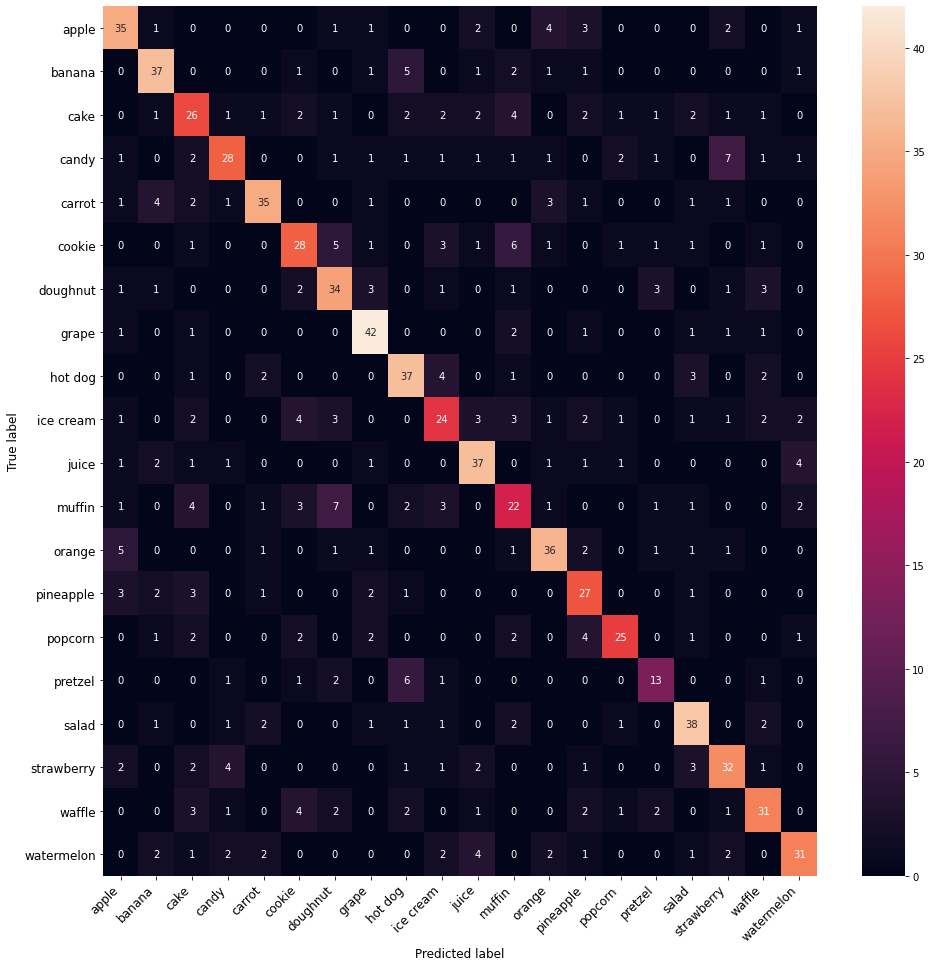

In [49]:
conf = compute_confusion_matrix(metrics, labels) 
plot_confusion_matrix(conf, labels, figsize=(16, 16))

you can get the accuracies for the individual classes from the confusion matrix

For each row of the confidence matrix, the number on the diagonal is how many images in this class that the model predicted correctly. You’re dividing this number by the sum over that row, which is the total number of test images in that class.

In [52]:
for i, label in enumerate(labels):
    correct = conf[i, i]
    images_per_class = conf[i].sum()
    print("%10s %.1f%%" % (label, 100. * correct/
    images_per_class))

     apple 70.0%
    banana 74.0%
      cake 52.0%
     candy 56.0%
    carrot 70.0%
    cookie 56.0%
  doughnut 68.0%
     grape 84.0%
   hot dog 74.0%
 ice cream 48.0%
     juice 74.0%
    muffin 45.8%
    orange 72.0%
 pineapple 67.5%
   popcorn 62.5%
   pretzel 52.0%
     salad 76.0%
strawberry 65.3%
    waffle 62.0%
watermelon 62.0%


Training the classifier with regularization. 
Regularization and hyperparameter tuning won’t always work miracles, but they do improve the model, even if only a little bit.

Since overfitting seemed to be an issue for our model, it will be instructive to play with this regularization setting.

Setting the convergence_threshold to a very small value means that the training won’t stop until it has done all 200 iterations.
l2_penalty and l1_penalty are hyperparameters that add regularization to reduce overfitting.

Overfitting can happen when the model gives too much weight to some features, by giving them very large coefficients. Setting l2_penalty greater than 0 penalizes large coefficients, encouraging the model to learn smaller coefficients. Higher values of l2_penalty reduce the size of coefficients, but can also reduce the training accuracy.
Setting l1_penalty greater than 0 also penalizes large coefficients. In addition, it discards features that have very small coefficients, by setting these to 0. Typically, you’d use either l2_penalty or l1_penalty, but not both in the same training session.


In [53]:
model = tc.image_classifier.create(train_data, target="label", model="squeezenet_v1.1",
max_iterations=200, l1_penalty=0.0,
verbose=True, validation_set=val_data,
l2_penalty=10.0, convergence_threshold=1e-8)

Analyzing and extracting image features.

+------------------+--------------+------------------+

| Images Processed | Elapsed Time | Percent Complete |

+------------------+--------------+------------------+

| 64               | 830.202ms    | 1.25%            |

| 128              | 1.14s        | 2.5%             |

| 192              | 1.42s        | 3.75%            |

| 256              | 1.69s        | 5.25%            |

| 320              | 1.98s        | 6.5%             |

| 640              | 3.39s        | 13%              |

| 1600             | 7.20s        | 32.75%           |

| 3200             | 14.47s       | 65.75%           |

| 4800             | 21.10s       | 98.5%            |

| 4838             | 21.37s       | 100%             |

+------------------+--------------+------------------+

Analyzing and extracting image features.

+------------------+--------------+------------------+

| Images Processed | Elapsed Time | Percent Complete |

+------------------+--------------+------------------+

| 64               | 755.55ms     | 6.5%             |

| 128              | 1.02s        | 13.25%           |

| 192              | 1.28s        | 20%              |

| 256              | 1.55s        | 26.5%            |

| 320              | 1.80s        | 33.25%           |

| 640              | 2.98s        | 66.5%            |

| 955              | 4.27s        | 100%             |

+------------------+--------------+------------------+

Logistic regression:

--------------------------------------------------------

Number of examples          : 4838

Number of classes           : 20

Number of feature columns   : 1

Number of unpacked features : 1000

Number of coefficients      : 19019

Starting L-BFGS

--------------------------------------------------------

+-----------+----------+-----------+--------------+-------------------+---------------------+

| Iteration | Passes   | Step size | Elapsed Time | Training Accuracy | Validation Accuracy |

+-----------+----------+-----------+--------------+-------------------+---------------------+

| 0         | 4        | 0.250000  | 0.518139     | 0.078338          | 0.070157            |

| 1         | 7        | 1.250000  | 1.011516     | 0.295163          | 0.273298            |

| 2         | 8        | 1.250000  | 1.266730     | 0.139107          | 0.150785            |

| 3         | 9        | 1.250000  | 1.514166     | 0.272427          | 0.268063            |

| 4         | 10       | 1.250000  | 1.757367     | 0.243282          | 0.215707            |

| 9         | 17       | 1.000000  | 3.170749     | 0.446879          | 0.406283            |

| 19        | 30       | 1.000000  | 5.957552     | 0.573584          | 0.530890            |

| 29        | 41       | 1.000000  | 8.585393     | 0.623398          | 0.568586            |

| 39        | 59       | 1.000000  | 12.049614    | 0.674866          | 0.598953            |

| 49        | 73       | 1.000000  | 14.870613    | 0.701116          | 0.601047            |

| 59        | 84       | 1.000000  | 17.495034    | 0.720752          | 0.625131            |

| 69        | 97       | 1.000000  | 20.337358    | 0.741215          | 0.635602            |

| 79        | 112      | 0.759634  | 23.385285    | 0.751550          | 0.637696            |

| 89        | 124      | 0.994830  | 26.102464    | 0.764986          | 0.645026            |

| 99        | 137      | 1.000000  | 28.778602    | 0.767879          | 0.640838            |

| 109       | 149      | 1.000000  | 31.652656    | 0.769740          | 0.646073            |

| 119       | 163      | 1.000000  | 34.760742    | 0.778007          | 0.645026            |

| 129       | 178      | 1.000000  | 37.793033    | 0.786482          | 0.642932            |

| 139       | 189      | 1.000000  | 40.481391    | 0.787309          | 0.647120            |

| 149       | 203      | 1.000000  | 43.826496    | 0.789376          | 0.648168            |

| 159       | 222      | 1.358343  | 47.429055    | 0.788549          | 0.649215            |

| 169       | 234      | 1.000000  | 50.207677    | 0.788136          | 0.650262            |

| 179       | 263      | 1.506199  | 55.089612    | 0.788756          | 0.646073            |

| 189       | 281      | 1.000000  | 59.002839    | 0.788342          | 0.649215            |

| 199       | 292      | 1.000000  | 62.272333    | 0.789169          | 0.652356            |

+-----------+----------+-----------+--------------+-------------------+---------------------+

.

.

.

.

.

.

.

.

.

  
  
  
  

MXFeatureExtractor is an object from the MXNet machine learning framework that Turi Create is built on

In [56]:
from turicreate.toolkits import _pre_trained_models
from turicreate.toolkits import _image_feature_extractor
ptModel = _pre_trained_models.MODELS["squeezenet_v1.1"]() 
feature_extractor = _image_feature_extractor.MXFeatureExtractor(ptModel)

You’re using the MXFeatureExtractor object to extract the SqueezeNet features from the training dataset. This is the operation that took the most time when you ran tc.image_classifier.create(). By running this separately now, you won’t have wait for feature extraction every time you want to train the classifier.

In [57]:
train_features = feature_extractor.extract_features(train_data, "image", verbose=True)

Performing feature extraction on resized images...
Completed   64/4838
Completed  128/4838
Completed  192/4838
Completed  256/4838
Completed  320/4838
Completed  384/4838
Completed  448/4838
Completed  512/4838
Completed  576/4838
Completed  640/4838
Completed  704/4838
Completed  768/4838
Completed  832/4838
Completed  896/4838
Completed  960/4838
Completed 1024/4838
Completed 1088/4838
Completed 1152/4838
Completed 1216/4838
Completed 1280/4838
Completed 1344/4838
Completed 1408/4838
Completed 1472/4838
Completed 1536/4838
Completed 1600/4838
Completed 1664/4838
Completed 1728/4838
Completed 1792/4838
Completed 1856/4838
Completed 1920/4838
Completed 1984/4838
Completed 2048/4838
Completed 2112/4838
Completed 2176/4838
Completed 2240/4838
Completed 2304/4838
Completed 2368/4838
Completed 2432/4838
Completed 2496/4838
Completed 2560/4838
Completed 2624/4838
Completed 2688/4838
Completed 2752/4838
Completed 2816/4838
Completed 2880/4838
Completed 2944/4838
Completed 3008/4838
Completed

Here, you’re just combining the features of each image with its respective label into a new SFrame. 

In [58]:
extracted_train_features = tc.SFrame({ 
    "label": train_data["label"], "__image_features__": train_features, 
})

In [59]:
extracted_train_features.save("extracted_train_features.sframe")

You’re saving extracted_train_features to a file. 
The next time you want to do more training with these same features, you can simply load the SFrame again, which takes a fraction of the time it took to extract the features:

In [60]:
 # Run this tomorrow or next week
extracted_train_features = tc.SFrame("extracted_train_features.sframe")

In [61]:
extracted_train_features.head()

__image_features__,label
"[6.133738040924072,10.128445625305176, ...",apple
"[9.666999816894531,14.665329933166504, ...",apple
"[10.662521362304688,15.472965240478516, ...",apple
"[12.159002304077148,11.23139476776123, ...",apple
"[17.9743709564209,19.089574813842773, ...",apple
"[5.87977933883667,9.116366386413574, ...",apple
"[6.74898624420166,6.330110549926758, ...",apple
"[5.711240291595459,13.0549898147583, ...",apple
"[8.625848770141602,6.533730983734131, ...",apple
"[6.440614700317383,13.472397804260254, ...",apple


they are features that SqueezeNet has determined to be important — how long, round, square, orange, etc. the objects are. All that matters is that you can train a logistic classifier to learn from these features.

In [62]:
extracted_train_features[0]["__image_features__"]

array('d', [6.133738040924072, 10.128445625305176, 13.02511215209961, 7.93119478225708, 12.038104057312012, 15.103206634521484, 12.722896575927734, 10.93090534210205, 12.7783203125, 14.20803451538086, 16.8399715423584, 11.781681060791016, 18.99500274658203, 17.461008071899414, 18.71087074279785, 12.68094539642334, 13.507373809814453, 11.648833274841309, 12.983747482299805, 10.726639747619629, 14.919912338256836, 12.12971305847168, 11.414222717285156, 14.733705520629883, 9.810264587402344, 10.89663028717041, 18.019433975219727, 15.979008674621582, 13.082319259643555, 13.18386173248291, 9.810114860534668, 12.890342712402344, 17.385116577148438, 12.061918258666992, 12.310941696166992, 12.09420394897461, 14.050445556640625, 13.809377670288086, 18.275421142578125, 16.623279571533203, 17.035625457763672, 22.04035758972168, 16.95296287536621, 13.085403442382812, 20.951560974121094, 13.966251373291016, 16.579862594604492, 16.847400665283203, 14.338920593261719, 16.345020294189453, 13.959557533

In [63]:
val_features = feature_extractor.extract_features(val_data, "image", verbose=True)

extracted_val_features = tc.SFrame({ 
    "label": val_data["label"], '__image_features__': val_features,
     }) 

extracted_val_features.save("extracted_val_features.sframe")

Performing feature extraction on resized images...
Completed  64/955
Completed 128/955
Completed 192/955
Completed 256/955
Completed 320/955
Completed 384/955
Completed 448/955
Completed 512/955
Completed 576/955
Completed 640/955
Completed 704/955
Completed 768/955
Completed 832/955
Completed 896/955
Completed 955/955


Training the classifier

This is the Turi Create code that creates and trains the logistic regression model using the extracted_train_features SFrame as the input data, and extracted_val_features for validation.

In [64]:
lr_model = tc.logistic_classifier.create(extracted_train_features,
                                         features=["__image_features__"], target="label",
                                         validation_set=extracted_val_features, max_iterations=200,
                                         seed=None, verbose=True, l2_penalty=10.0, l1_penalty=0.0, 
                                         convergence_threshold=1e-8)

Logistic regression:

--------------------------------------------------------

Number of examples          : 4838

Number of classes           : 20

Number of feature columns   : 1

Number of unpacked features : 1000

Number of coefficients      : 19019

Starting L-BFGS

--------------------------------------------------------

+-----------+----------+-----------+--------------+-------------------+---------------------+

| Iteration | Passes   | Step size | Elapsed Time | Training Accuracy | Validation Accuracy |

+-----------+----------+-----------+--------------+-------------------+---------------------+

| 0         | 4        | 0.250000  | 0.362704     | 0.078338          | 0.070157            |

| 1         | 7        | 1.250000  | 0.731409     | 0.294750          | 0.273298            |

| 2         | 8        | 1.250000  | 0.933938     | 0.139314          | 0.150785            |

| 3         | 9        | 1.250000  | 1.136881     | 0.272220          | 0.268063            |

| 4         | 10       | 1.250000  | 1.335405     | 0.243696          | 0.215707            |

| 9         | 17       | 1.000000  | 2.516108     | 0.447499          | 0.406283            |

| 24        | 35       | 1.000000  | 6.030855     | 0.600248          | 0.553927            |

| 49        | 73       | 1.000000  | 13.561818    | 0.704217          | 0.602094            |

| 74        | 116      | 1.000000  | 21.492151    | 0.749070          | 0.631414            |

| 99        | 162      | 1.064999  | 29.739374    | 0.768913          | 0.639791            |

| 124       | 197      | 0.966814  | 37.029189    | 0.778214          | 0.642932            |

| 149       | 242      | 0.810537  | 45.342966    | 0.782968          | 0.649215            |

| 174       | 281      | 0.534981  | 52.730370    | 0.788962          | 0.648168            |

| 199       | 315      | 1.000000  | 59.679077    | 0.788136          | 0.649215            |

+-----------+----------+-----------+--------------+-------------------+---------------------+

In [66]:
#There are a few other hyperparameters you can set here as well: 
#feature_rescaling, solver, step_size and lbfgs_memory_level.

tc.logistic_classifier.create?

In [67]:
from turicreate.toolkits.image_classifier import ImageClassifier

state = {
    'classifier': lr_model,
    'model': ptModel.name,
    'max_iterations': lr_model.max_iterations, 'feature_extractor': feature_extractor, 'input_image_shape': ptModel.input_image_shape, 'target': lr_model.target,
    'feature': "image",
    'num_features': 1,
    'num_classes': lr_model.num_classes,
    'classes': lr_model.classes,
    'num_examples': lr_model.num_examples, 'training_time': lr_model.training_time, 'training_loss': lr_model.training_loss,
    }

model = ImageClassifier(state)

In [69]:
metrics = model.evaluate(test_data) 
print("Accuracy: ", metrics["accuracy"]) 
print("Precision: ", metrics["precision"]) 
print("Recall: ", metrics["recall"])

Performing feature extraction on resized images...
Completed  64/952
Completed 128/952
Completed 192/952
Completed 256/952
Completed 320/952
Completed 384/952
Completed 448/952
Completed 512/952
Completed 576/952
Completed 640/952
Completed 704/952
Completed 768/952
Completed 832/952
Completed 896/952
Completed 952/952


/Users/itsupport/anaconda3/envs/turienv/lib/python3.7/site-packages/turicreate/aggregate.py:91: UserWarning: Passing parameter(s) to COUNT is deprecated. This functionality will be removed in the next major release. Any passed parameters are ignored.
  warnings.warn('Passing parameter(s) to COUNT is deprecated. This functionality will be removed in '


Accuracy:  0.667016806722689
Precision:  0.6697373239463545
Recall:  0.665298469387755


Saving the model

In [70]:
model.save("MultiSnacks_regularized.model")

In [71]:
model.export_coreml("MultiSnacks_regularized.mlmodel")

In [72]:
model

Class                                    : ImageClassifier

Schema
------
Number of classes                        : 20
Number of feature columns                : 1
Input image shape                        : (3, 227, 227)

Training summary
----------------
Number of examples                       : 4838
Training loss                            : 3961.6958
Training time (sec)                      : 32.1754

In [73]:
model.classifier

Class                          : LogisticClassifier

Schema
------
Number of coefficients         : 19019
Number of examples             : 4838
Number of classes              : 20
Number of feature columns      : 1
Number of unpacked features    : 1000

Hyperparameters
---------------
L1 penalty                     : 0.0
L2 penalty                     : 10.0

Training Summary
----------------
Solver                         : lbfgs
Solver iterations              : 200
Solver status                  : Completed (Iteration limit reached).
Training time (sec)            : 32.1754

Settings
--------
Log-likelihood                 : 3961.6958

Highest Positive Coefficients
-----------------------------
(intercept)                    : 0.3909
(intercept)                    : 0.2657
(intercept)                    : 0.1426
(intercept)                    : 0.096
(intercept)                    : 0.0878

Lowest Negative Coefficients
----------------------------
(intercept)                    : -0.